In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import RandomOverSampler
import numpy as np
from sklearn.model_selection import train_test_split
import os, cv2
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Flatten, Dense, MaxPool2D

In [2]:
import pandas as pd

In [3]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [4]:
data = pd.read_csv('/content/drive/MyDrive/DeepLearningProject/hmnist_28_28_RGB.csv')
data.head()

,pixel0000,pixel0001,pixel0002,pixel0003,pixel0004,pixel0005,pixel0006,pixel0007,pixel0008,pixel0009,...,pixel2343,pixel2344,pixel2345,pixel2346,pixel2347,pixel2348,pixel2349,pixel2350,pixel2351,label
0,192,153,193,195,155,192,197,154,185,202,...,173,124,138,183,147,166,185,154,177,2
1,25,14,30,68,48,75,123,93,126,158,...,60,39,55,25,14,28,25,14,27,2
2,192,138,153,200,145,163,201,142,160,206,...,167,129,143,159,124,142,136,104,117,2
3,38,19,30,95,59,72,143,103,119,171,...,44,26,36,25,12,17,25,12,15,2
4,158,113,139,194,144,174,215,162,191,225,...,209,166,185,172,135,149,109,78,92,2


In [5]:
y = data['label']
x = data.drop(columns = ['label'])

In [6]:
x.head()

,pixel0000,pixel0001,pixel0002,pixel0003,pixel0004,pixel0005,pixel0006,pixel0007,pixel0008,pixel0009,...,pixel2342,pixel2343,pixel2344,pixel2345,pixel2346,pixel2347,pixel2348,pixel2349,pixel2350,pixel2351
0,192,153,193,195,155,192,197,154,185,202,...,134,173,124,138,183,147,166,185,154,177
1,25,14,30,68,48,75,123,93,126,158,...,82,60,39,55,25,14,28,25,14,27
2,192,138,153,200,145,163,201,142,160,206,...,149,167,129,143,159,124,142,136,104,117
3,38,19,30,95,59,72,143,103,119,171,...,73,44,26,36,25,12,17,25,12,15
4,158,113,139,194,144,174,215,162,191,225,...,201,209,166,185,172,135,149,109,78,92


In [7]:
y.head()

0    2
1    2
2    2
3    2
4    2
Name: label, dtype: int64

In [8]:
tabular_data = pd.read_csv('/content/drive/MyDrive/DeepLearningProject/HAM10000_metadata.csv')
tabular_data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [9]:
classes = {4: ('nv', ' melanocytic nevi'), 6: ('mel', 'melanoma'), 2 :('bkl', 'benign keratosis-like lesions'), 1:('bcc' , ' basal cell carcinoma'), 5: ('vasc', ' pyogenic granulomas and hemorrhage'), 0: ('akiec', 'Actinic keratoses and intraepithelial carcinomae'),  3: ('df', 'dermatofibroma')}

Text(0.5, 1.0, 'Frequency Distribution of Classes')

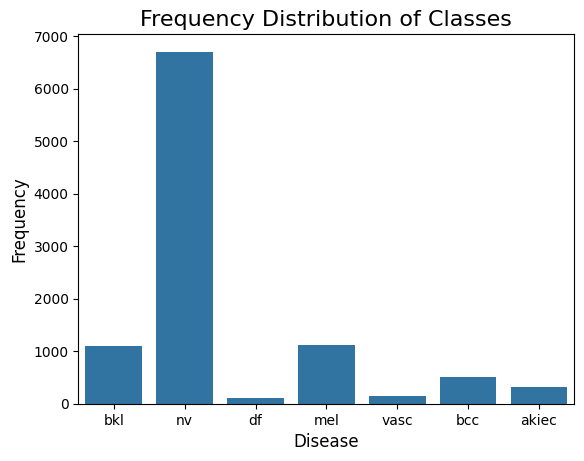

In [10]:
sns.countplot(x = 'dx', data = tabular_data)
plt.xlabel('Disease', size=12)
plt.ylabel('Frequency', size=12)
plt.title('Frequency Distribution of Classes', size=16)

Text(0.5, 1.0, 'Gender of Patient')

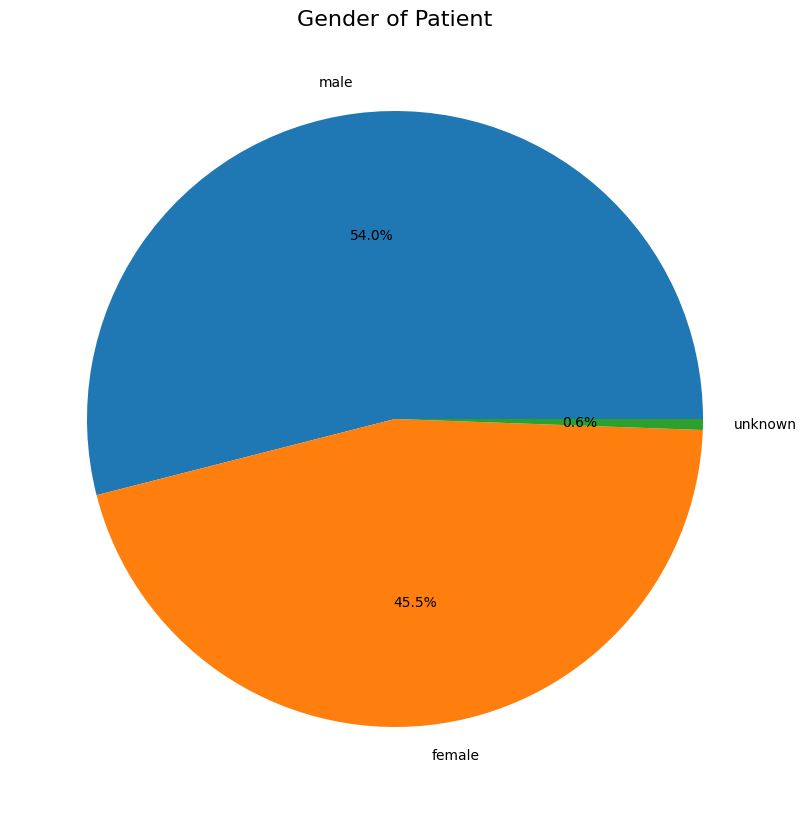

In [11]:
bar, ax = plt.subplots(figsize = (10,10))
plt.pie(tabular_data['sex'].value_counts(), labels = tabular_data['sex'].value_counts().index, autopct="%.1f%%")
plt.title('Gender of Patient', size=16)

Text(0.5, 1.0, 'Histogram of Age of Patients')

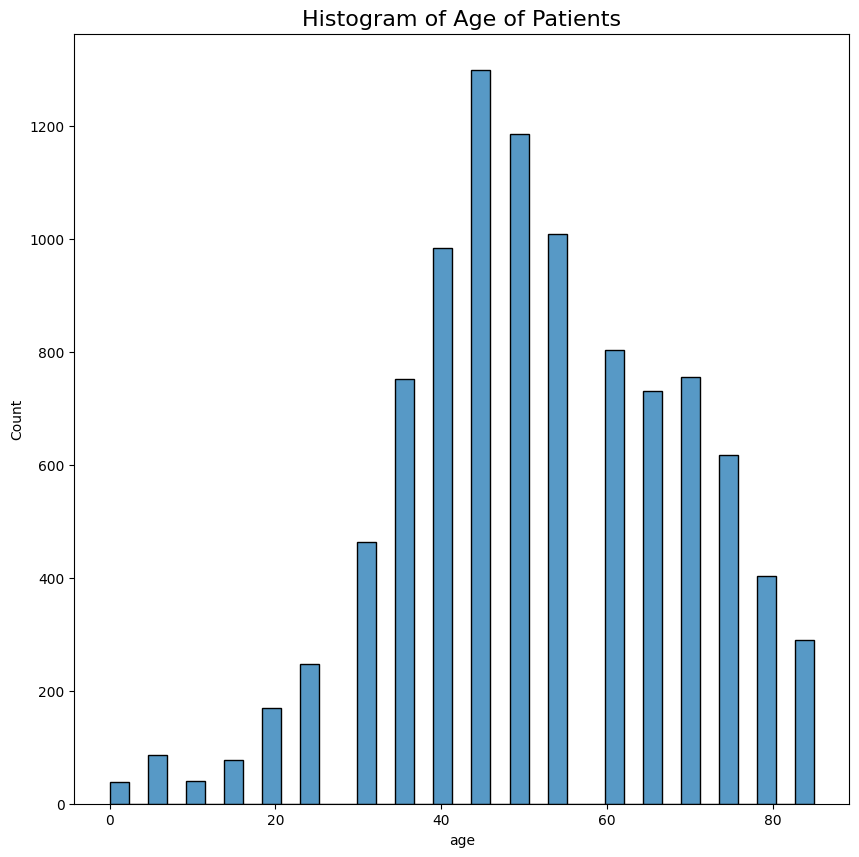

In [12]:
bar, ax = plt.subplots(figsize=(10,10))
sns.histplot(tabular_data['age'])
plt.title('Histogram of Age of Patients', size=16)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14],
 [Text(0, 0, 'back'),
  Text(1, 0, 'lower extremity'),
  Text(2, 0, 'trunk'),
  Text(3, 0, 'upper extremity'),
  Text(4, 0, 'abdomen'),
  Text(5, 0, 'face'),
  Text(6, 0, 'chest'),
  Text(7, 0, 'foot'),
  Text(8, 0, 'scalp'),
  Text(9, 0, 'neck'),
  Text(10, 0, 'unknown'),
  Text(11, 0, 'hand'),
  Text(12, 0, 'genital'),
  Text(13, 0, 'ear'),
  Text(14, 0, 'acral')])

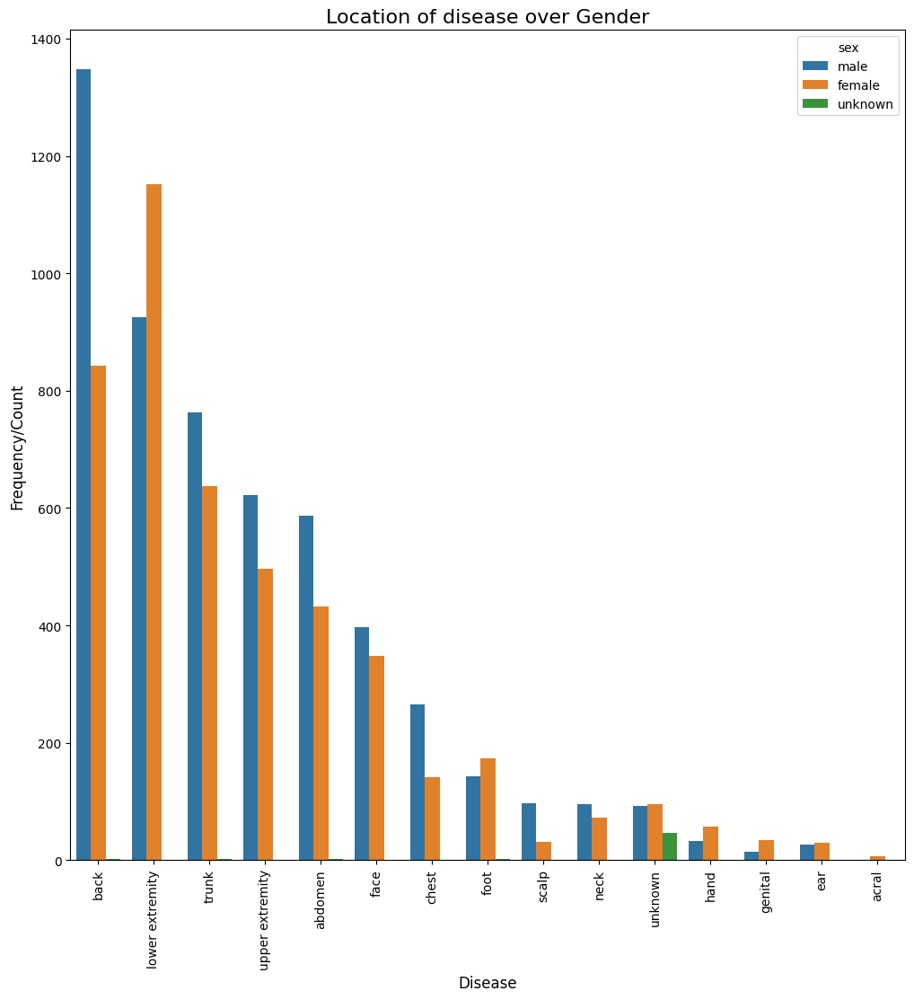

In [13]:
value = tabular_data[['localization', 'sex']].value_counts().to_frame()
value.reset_index(level=[1,0 ], inplace=True)
temp = value.rename(columns = {'localization':'location', 0: 'count'})

bar, ax = plt.subplots(figsize = (12, 12))
sns.barplot(x = 'location',  y='count', hue = 'sex', data = temp)
plt.title('Location of disease over Gender', size = 16)
plt.xlabel('Disease', size=12)
plt.ylabel('Frequency/Count', size=12)
plt.xticks(rotation = 90)

In [14]:
oversample = RandomOverSampler()
x,y  = oversample.fit_resample(x,y)

In [15]:
x = np.array(x).reshape(-1,28,28,3)
print('Shape of X :',x.shape)

Shape of X : (46935, 28, 28, 3)


In [16]:
x = (x-np.mean(x))/np.std(x)
X_train, X_test, Y_train, Y_test = train_test_split(x,y, test_size=0.2, random_state=1)

In [17]:
model = Sequential()
model.add(Conv2D(16, kernel_size = (3,3), input_shape = (28, 28, 3), activation = 'relu', padding = 'same'))
model.add(Conv2D(32, kernel_size = (3,3), activation = 'relu'))
model.add(MaxPool2D(pool_size = (2,2)))
model.add(Conv2D(32, kernel_size = (3,3), activation = 'relu', padding = 'same'))
model.add(Conv2D(64, kernel_size = (3,3), activation = 'relu'))
model.add(MaxPool2D(pool_size = (2,2), padding = 'same'))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(7, activation='softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 28, 28, 16)        448       
                                                                 
 conv2d_1 (Conv2D)           (None, 26, 26, 32)        4640      
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 13, 13, 32)        9248      
                                                                 
 conv2d_3 (Conv2D)           (None, 11, 11, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                   

In [18]:
callback = tf.keras.callbacks.ModelCheckpoint(filepath='best_model.h5',
                                                  monitor='val_acc', mode='max',
                                                 verbose=1)

In [19]:
model.compile(loss = 'sparse_categorical_crossentropy',
             optimizer = 'adam',
              metrics = ['accuracy'])
history = model.fit(X_train,
                    Y_train,
                    validation_split=0.2,
                    batch_size = 128,
                    epochs = 20,
                    callbacks=[callback])

Epoch 1/20
235/235 [==============================] - ETA: 0s - loss: 1.2593 - accuracy: 0.5085
Epoch 1: saving model to best_model.h5
235/235 [==============================] - 66s 263ms/step - loss: 1.2593 - accuracy: 0.5085 - val_loss: 0.8636 - val_accuracy: 0.6782
Epoch 2/20


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


235/235 [==============================] - ETA: 0s - loss: 0.6989 - accuracy: 0.7420
Epoch 2: saving model to best_model.h5
235/235 [==============================] - 60s 253ms/step - loss: 0.6989 - accuracy: 0.7420 - val_loss: 0.5797 - val_accuracy: 0.7858
Epoch 3/20
235/235 [==============================] - ETA: 0s - loss: 0.4744 - accuracy: 0.8278
Epoch 3: saving model to best_model.h5
235/235 [==============================] - 57s 241ms/step - loss: 0.4744 - accuracy: 0.8278 - val_loss: 0.4084 - val_accuracy: 0.8461
Epoch 4/20
235/235 [==============================] - ETA: 0s - loss: 0.3332 - accuracy: 0.8802
Epoch 4: saving model to best_model.h5
235/235 [==============================] - 56s 238ms/step - loss: 0.3332 - accuracy: 0.8802 - val_loss: 0.3428 - val_accuracy: 0.8784
Epoch 5/20
235/235 [==============================] - ETA: 0s - loss: 0.2455 - accuracy: 0.9141
Epoch 5: saving model to best_model.h5
235/235 [==============================] - 57s 241ms/step - loss: 0.2

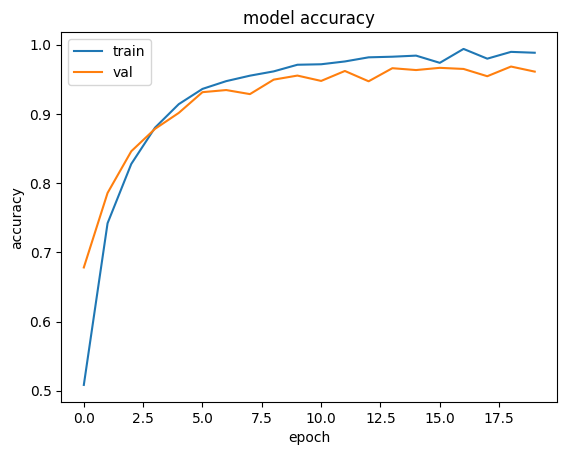

In [20]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

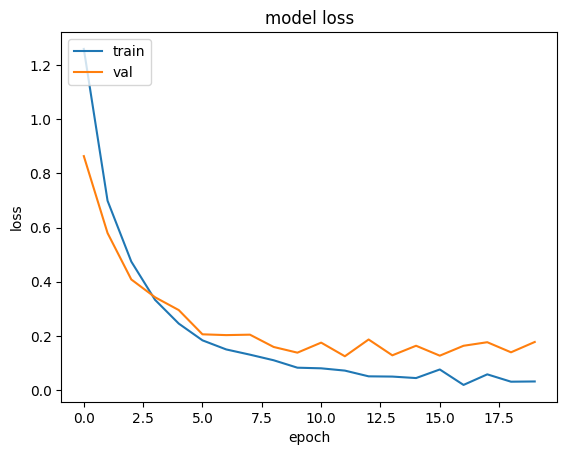

In [21]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [22]:
model.load_weights('best_model.h5')

In [23]:
loss, acc = model.evaluate(X_test, Y_test, verbose=2)

294/294 - 4s - loss: 0.1602 - accuracy: 0.9635 - 4s/epoch - 13ms/step


In [25]:
from google.colab.patches import cv2_imshow

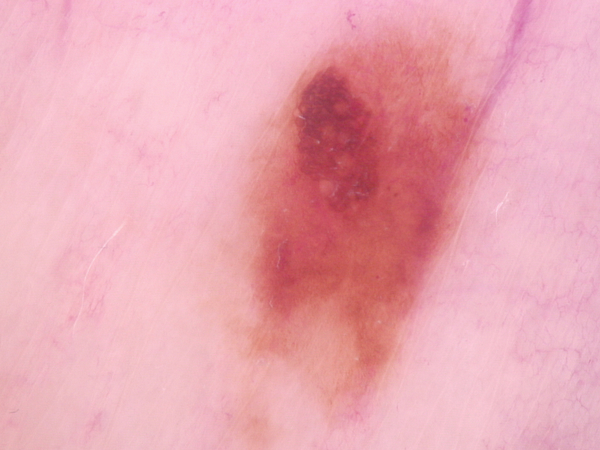

1/1 [==============================] - 0s 48ms/step
('nv', ' melanocytic nevi')


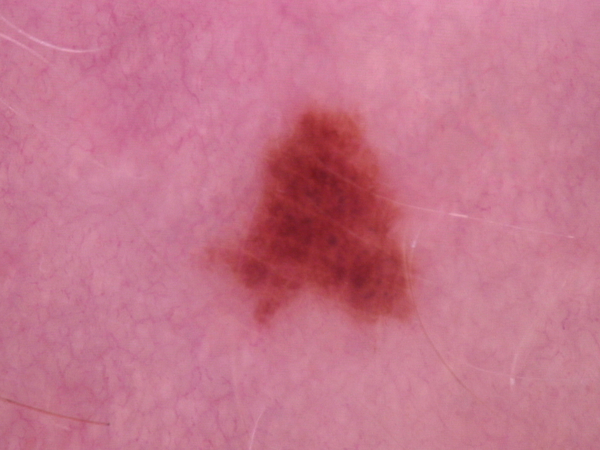

1/1 [==============================] - 0s 43ms/step
('nv', ' melanocytic nevi')


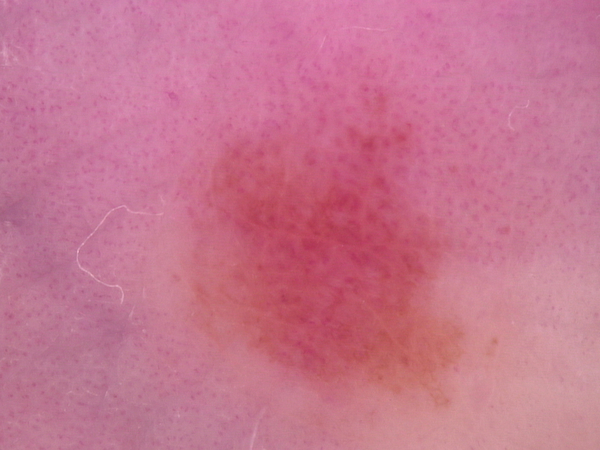

1/1 [==============================] - 0s 42ms/step
('nv', ' melanocytic nevi')


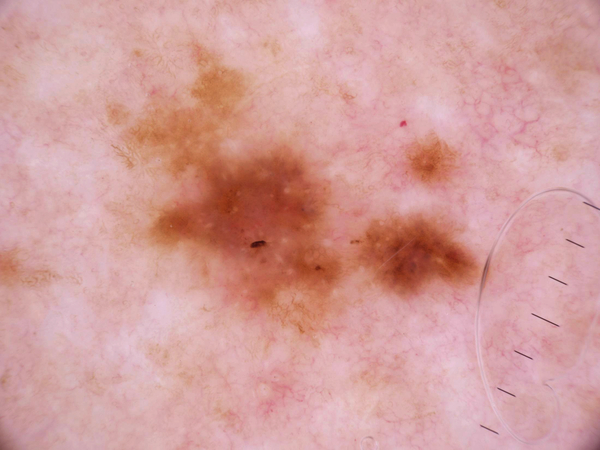

1/1 [==============================] - 0s 33ms/step
('nv', ' melanocytic nevi')


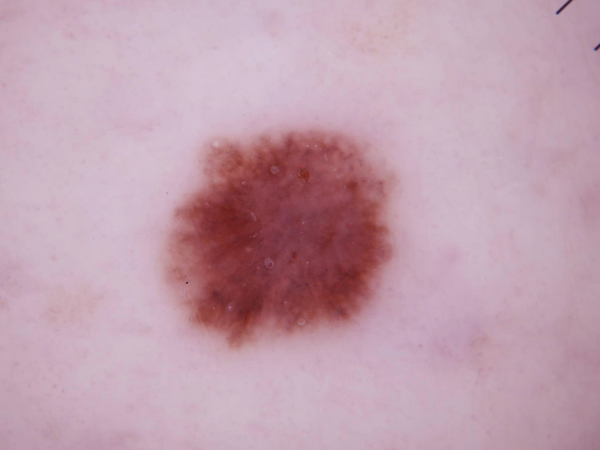

1/1 [==============================] - 0s 36ms/step
('nv', ' melanocytic nevi')


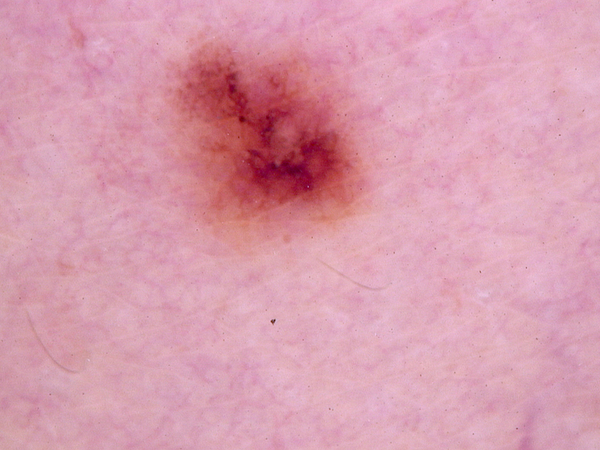

1/1 [==============================] - 0s 46ms/step
('nv', ' melanocytic nevi')


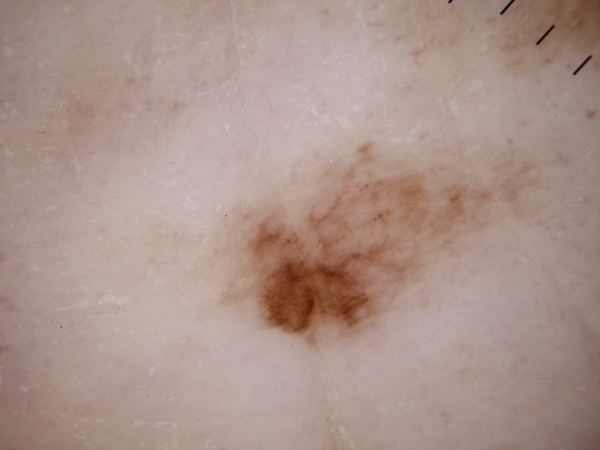

1/1 [==============================] - 0s 40ms/step
('nv', ' melanocytic nevi')


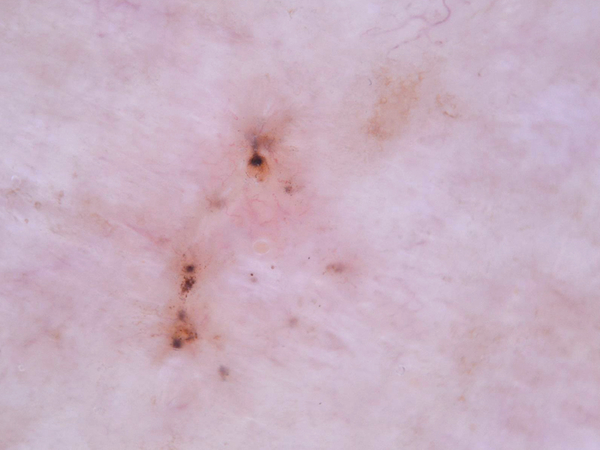

1/1 [==============================] - 0s 40ms/step
('nv', ' melanocytic nevi')


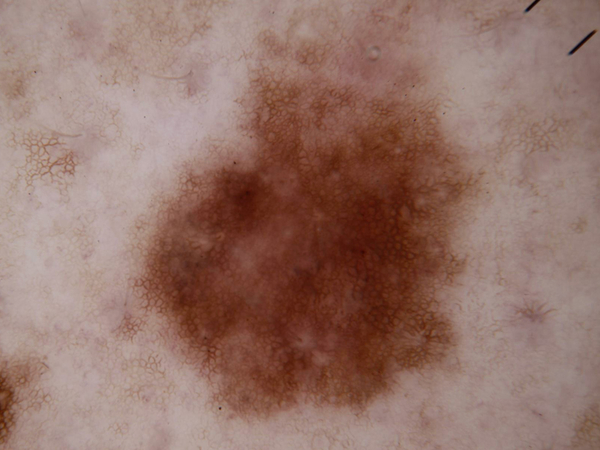

1/1 [==============================] - 0s 48ms/step
('nv', ' melanocytic nevi')


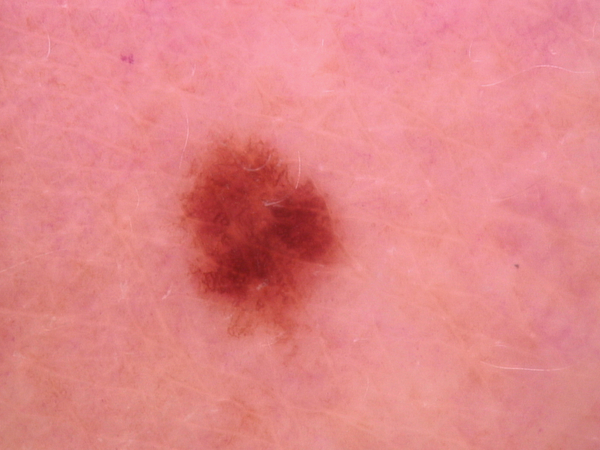

1/1 [==============================] - 0s 51ms/step
('nv', ' melanocytic nevi')


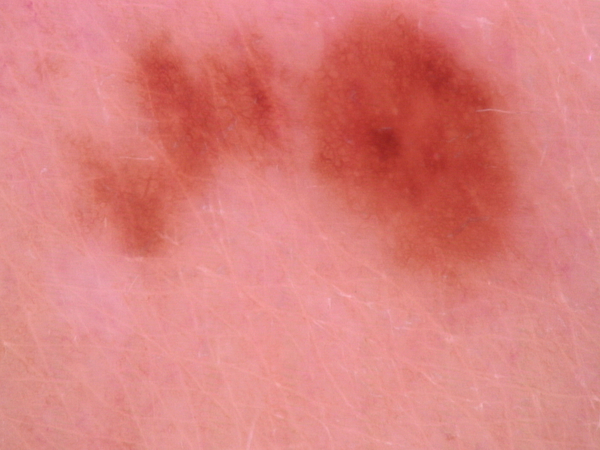

1/1 [==============================] - 0s 39ms/step
('nv', ' melanocytic nevi')


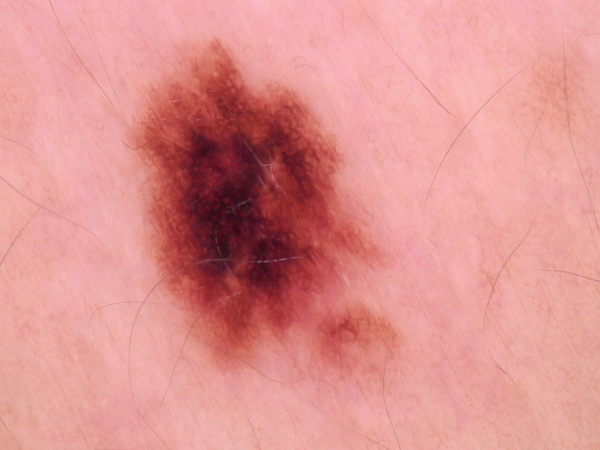

1/1 [==============================] - 0s 38ms/step
('nv', ' melanocytic nevi')


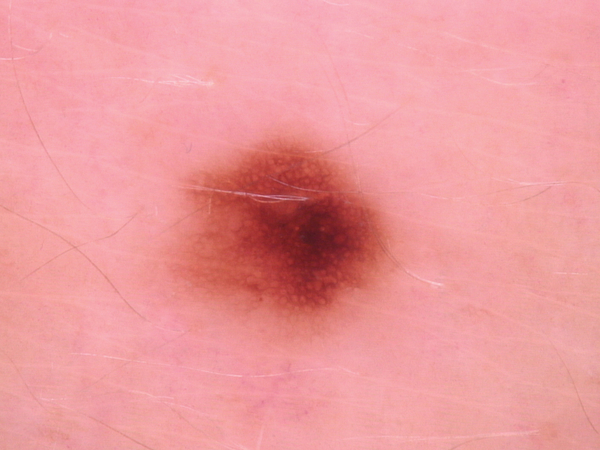

1/1 [==============================] - 0s 38ms/step
('nv', ' melanocytic nevi')


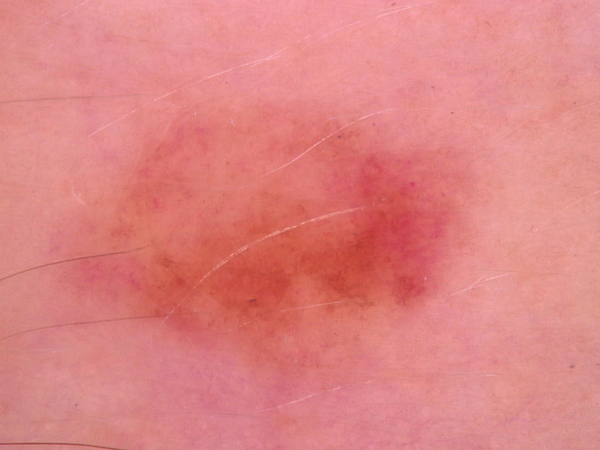

1/1 [==============================] - 0s 39ms/step
('nv', ' melanocytic nevi')


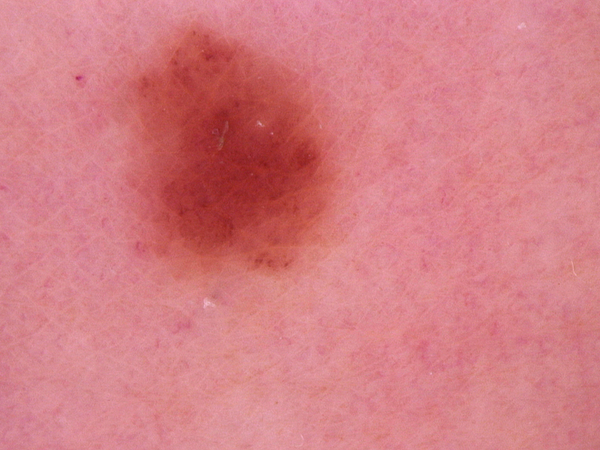

1/1 [==============================] - 0s 30ms/step
('nv', ' melanocytic nevi')


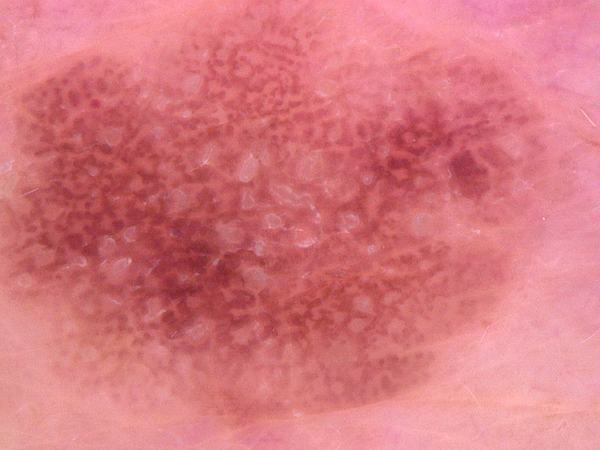

1/1 [==============================] - 0s 47ms/step
('nv', ' melanocytic nevi')


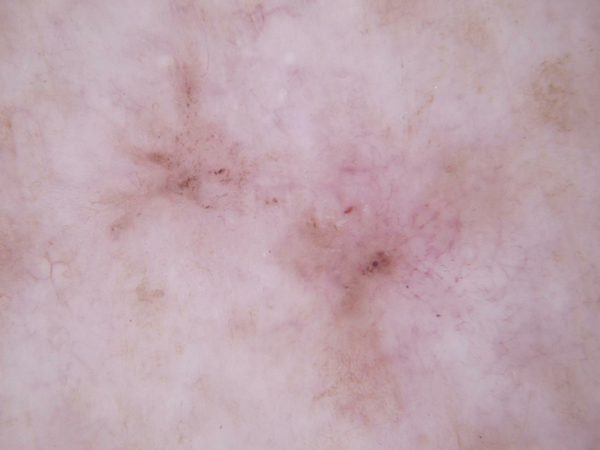

1/1 [==============================] - 0s 29ms/step
('nv', ' melanocytic nevi')


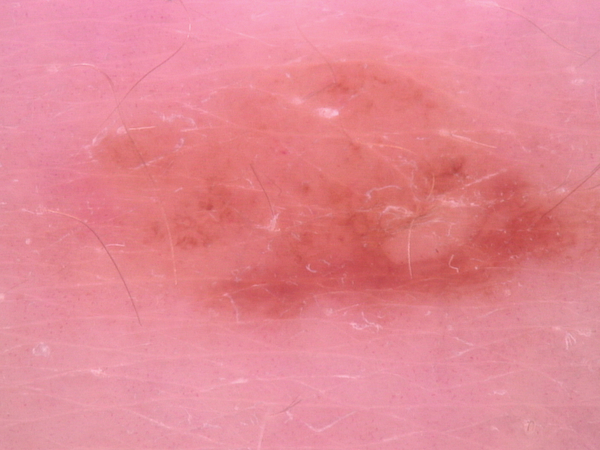

1/1 [==============================] - 0s 42ms/step
('nv', ' melanocytic nevi')


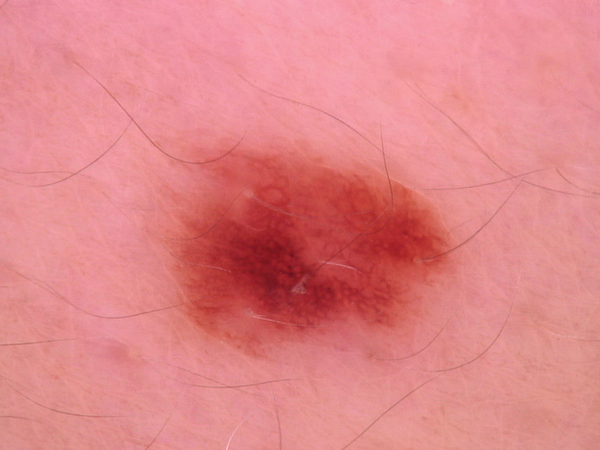

1/1 [==============================] - 0s 49ms/step
('nv', ' melanocytic nevi')


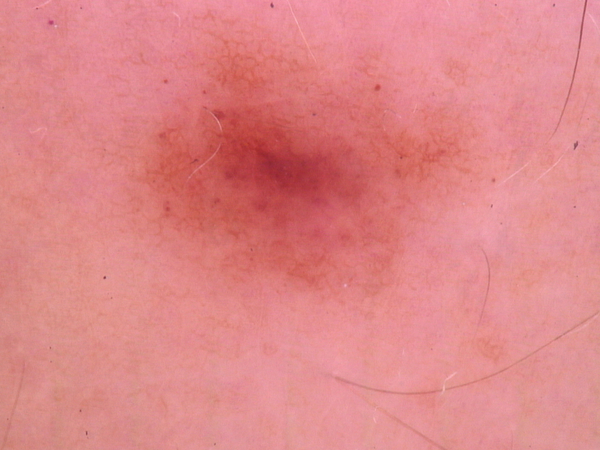

1/1 [==============================] - 0s 32ms/step
('nv', ' melanocytic nevi')


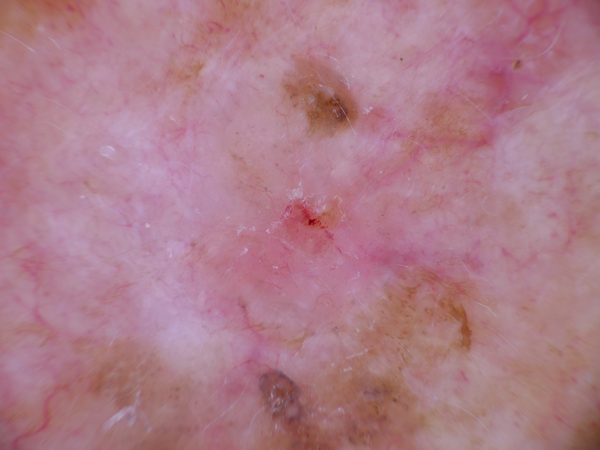

1/1 [==============================] - 0s 34ms/step
('nv', ' melanocytic nevi')


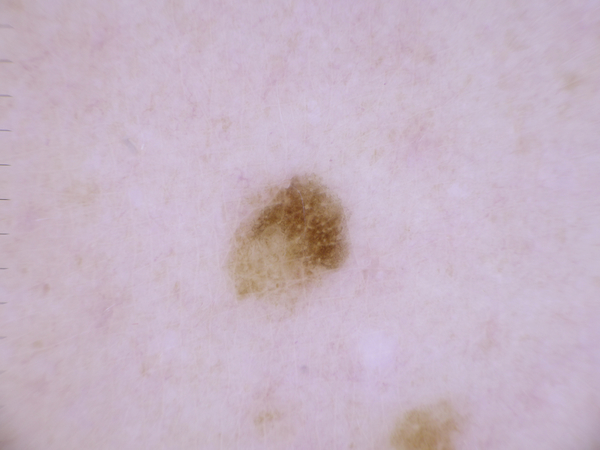

1/1 [==============================] - 0s 31ms/step
('nv', ' melanocytic nevi')


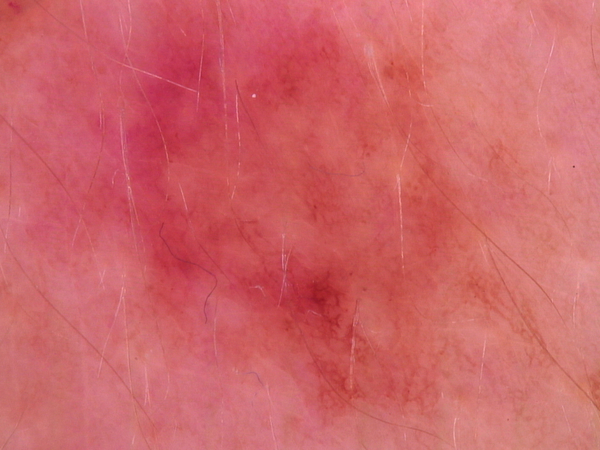

1/1 [==============================] - 0s 47ms/step
('nv', ' melanocytic nevi')


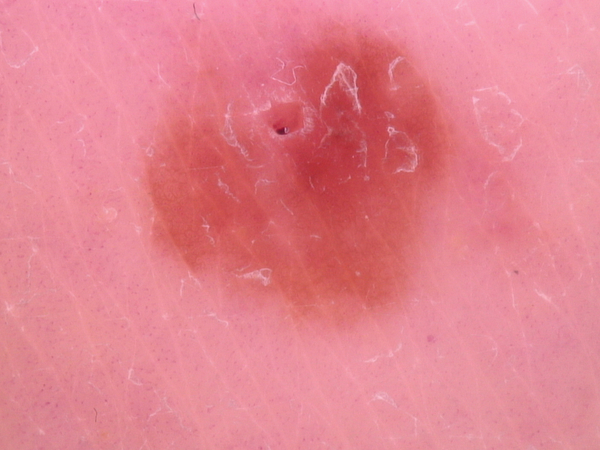

1/1 [==============================] - 0s 30ms/step
('nv', ' melanocytic nevi')


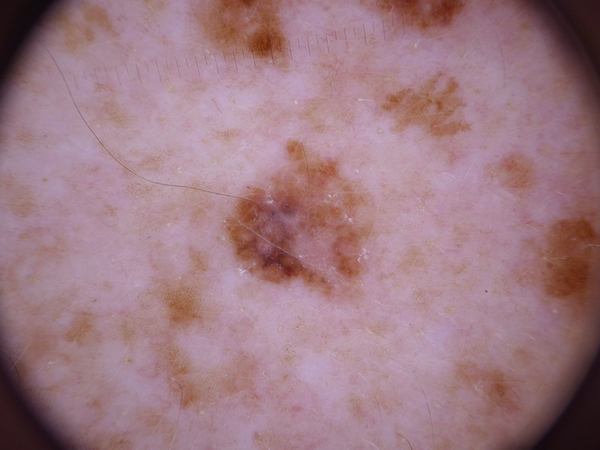

1/1 [==============================] - 0s 30ms/step
('bcc', ' basal cell carcinoma')


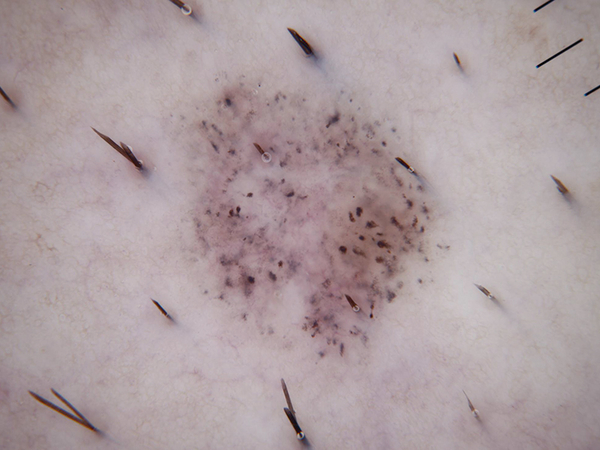

1/1 [==============================] - 0s 34ms/step
('nv', ' melanocytic nevi')


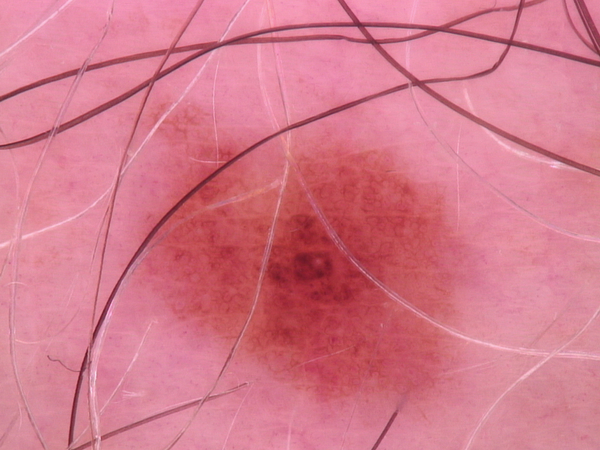

1/1 [==============================] - 0s 50ms/step
('nv', ' melanocytic nevi')


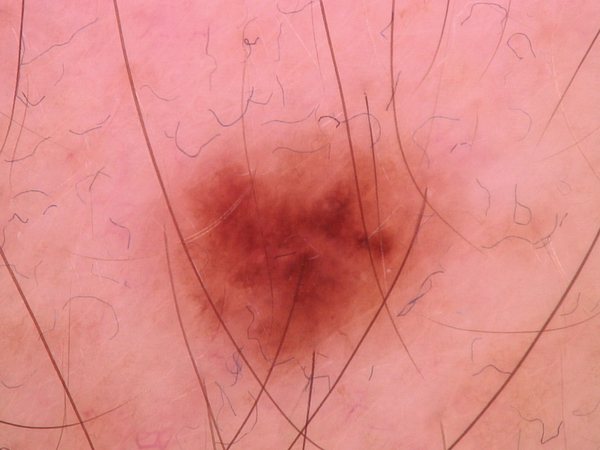

1/1 [==============================] - 0s 31ms/step
('nv', ' melanocytic nevi')


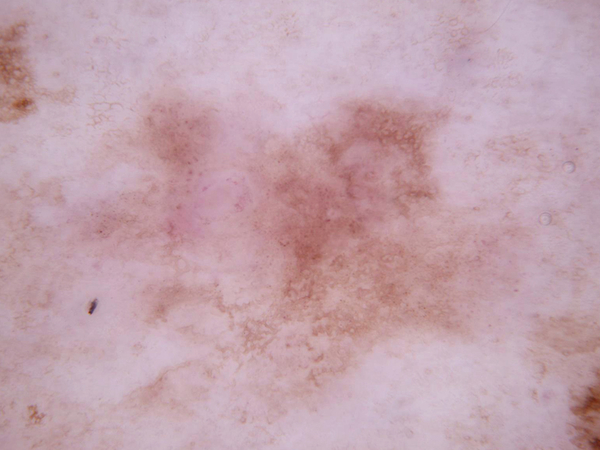

1/1 [==============================] - 0s 47ms/step
('nv', ' melanocytic nevi')


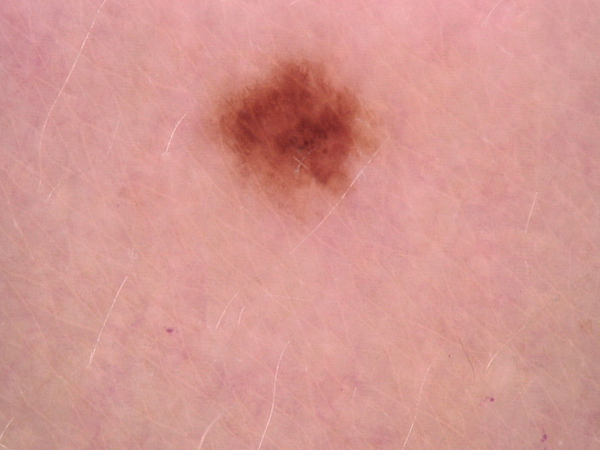

1/1 [==============================] - 0s 43ms/step
('nv', ' melanocytic nevi')


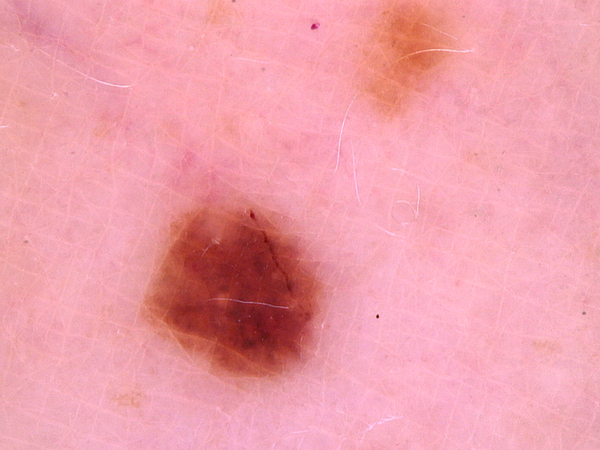

1/1 [==============================] - 0s 31ms/step
('nv', ' melanocytic nevi')


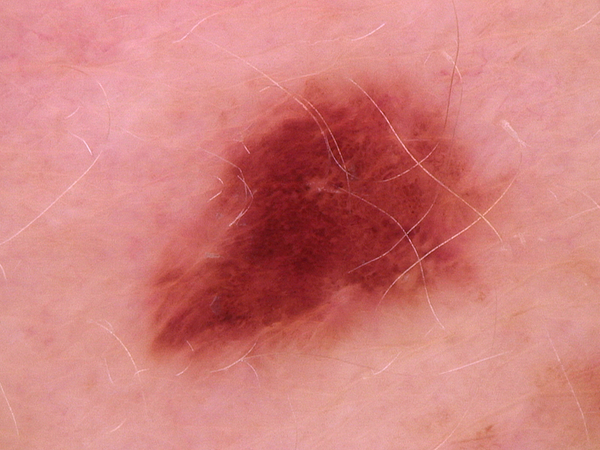

1/1 [==============================] - 0s 29ms/step
('nv', ' melanocytic nevi')


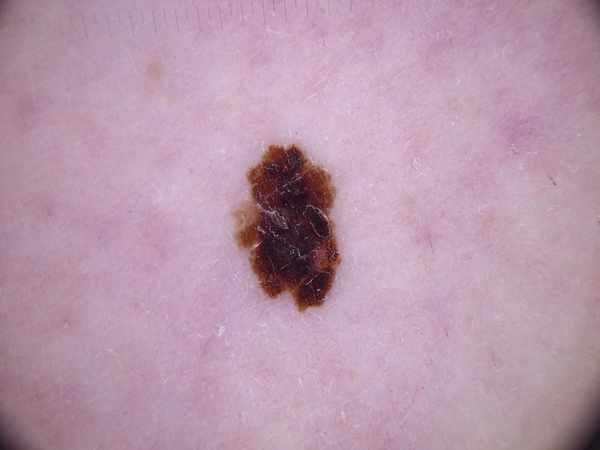

1/1 [==============================] - 0s 34ms/step
('nv', ' melanocytic nevi')


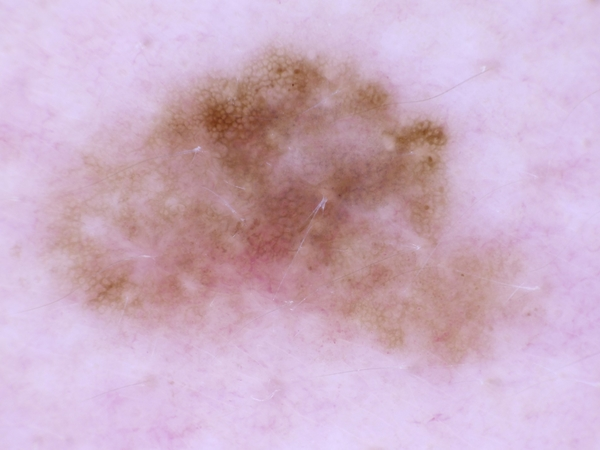

1/1 [==============================] - 0s 34ms/step
('nv', ' melanocytic nevi')


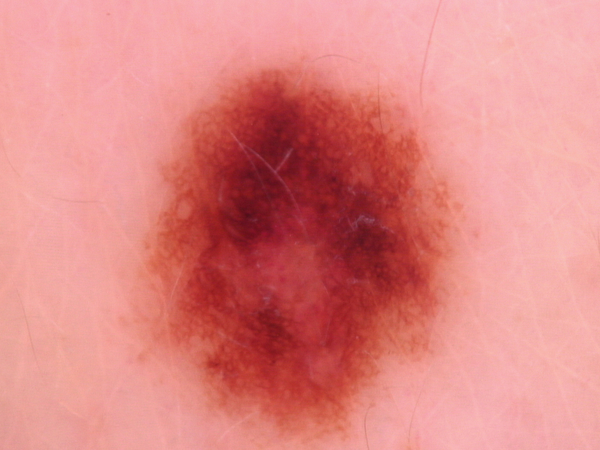

1/1 [==============================] - 0s 35ms/step
('nv', ' melanocytic nevi')


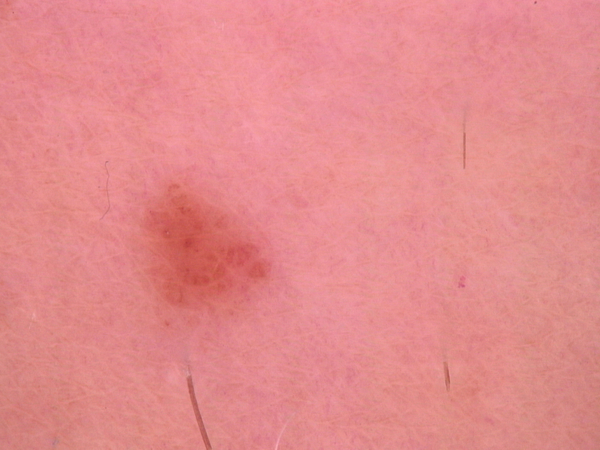

1/1 [==============================] - 0s 37ms/step
('nv', ' melanocytic nevi')


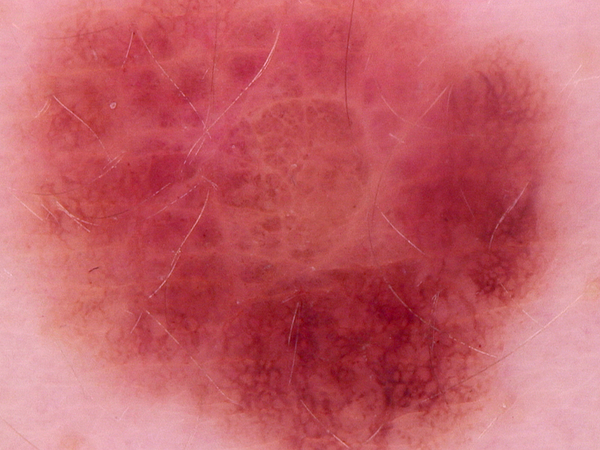

1/1 [==============================] - 0s 33ms/step
('nv', ' melanocytic nevi')


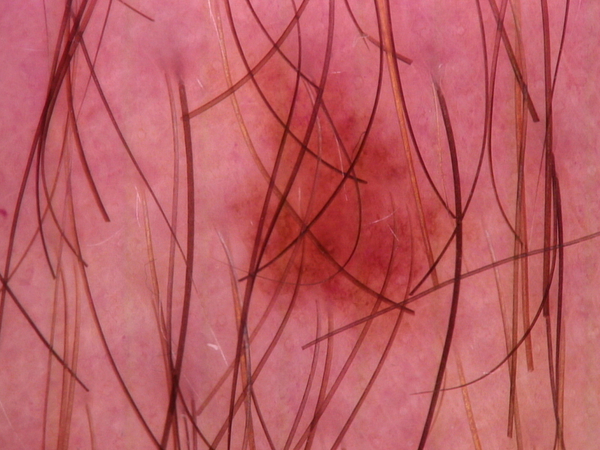

1/1 [==============================] - 0s 32ms/step
('nv', ' melanocytic nevi')


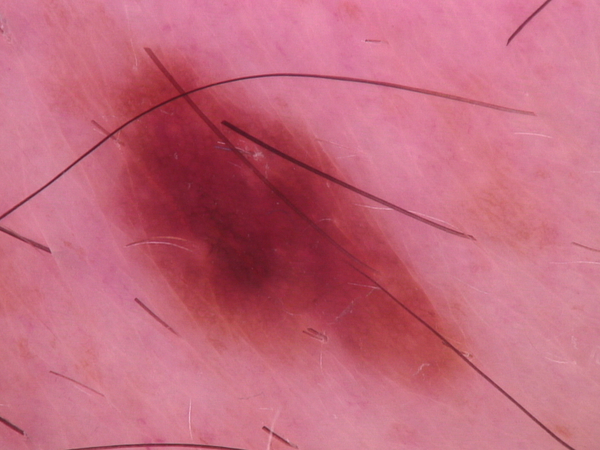

1/1 [==============================] - 0s 30ms/step
('nv', ' melanocytic nevi')


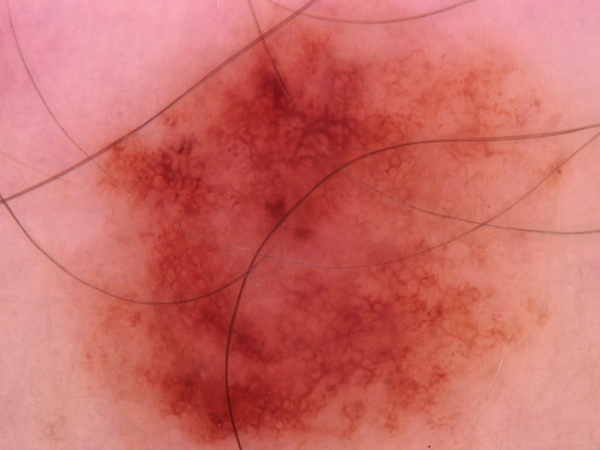

1/1 [==============================] - 0s 34ms/step
('nv', ' melanocytic nevi')


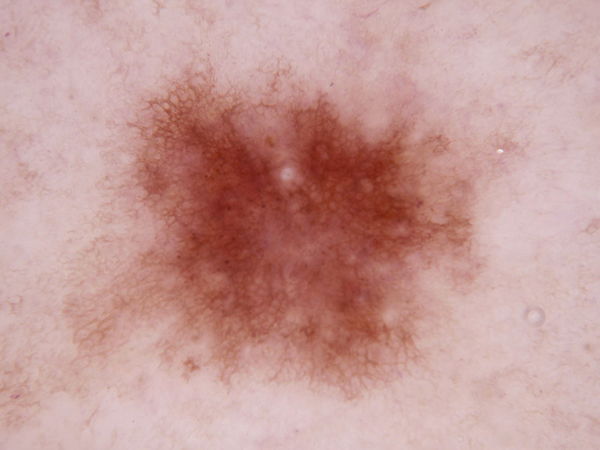

1/1 [==============================] - 0s 35ms/step
('nv', ' melanocytic nevi')


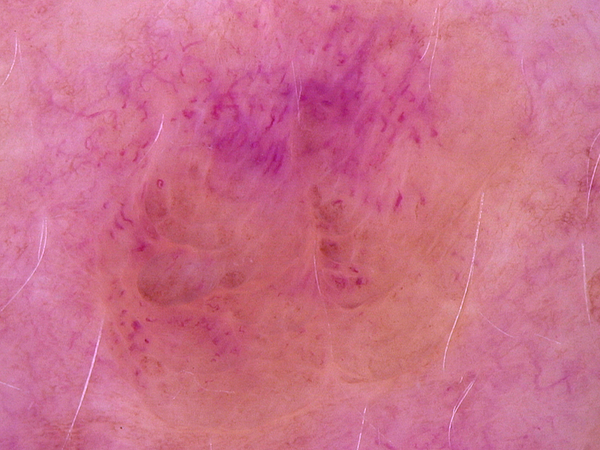

1/1 [==============================] - 0s 36ms/step
('nv', ' melanocytic nevi')


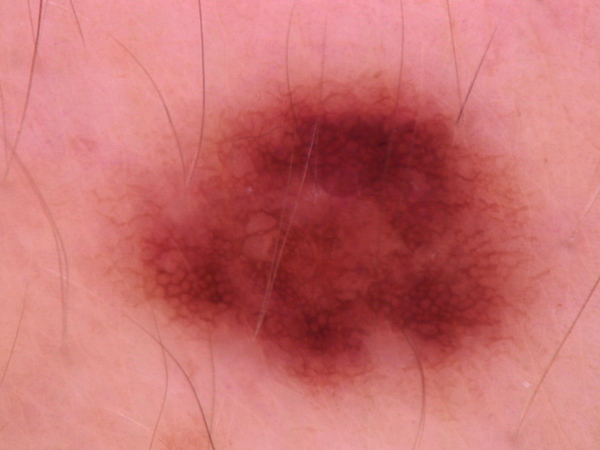

1/1 [==============================] - 0s 69ms/step
('nv', ' melanocytic nevi')


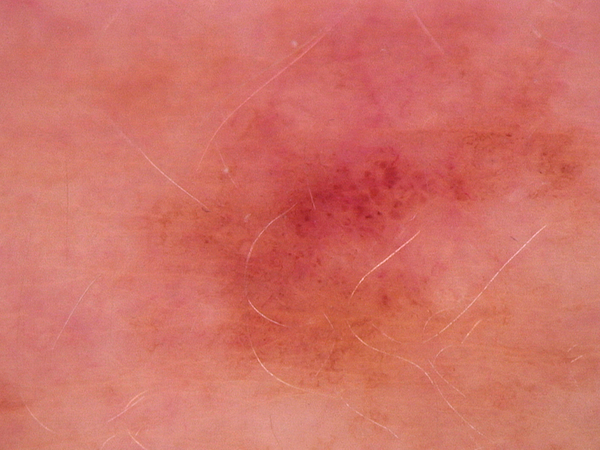

1/1 [==============================] - 0s 37ms/step
('nv', ' melanocytic nevi')


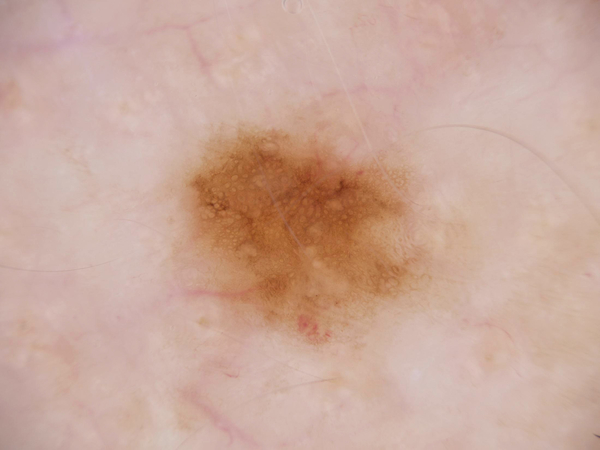

1/1 [==============================] - 0s 55ms/step
('nv', ' melanocytic nevi')


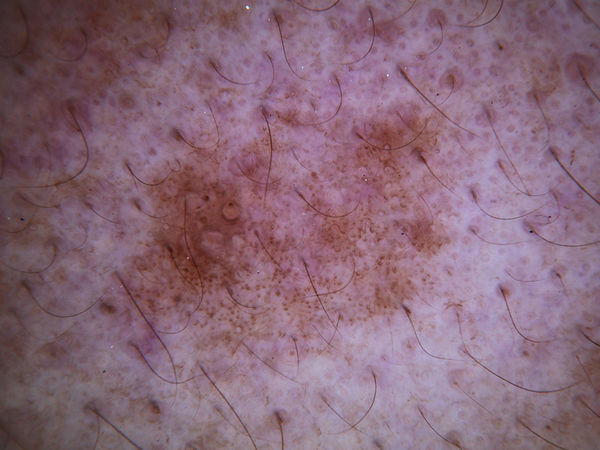

1/1 [==============================] - 0s 54ms/step
('nv', ' melanocytic nevi')


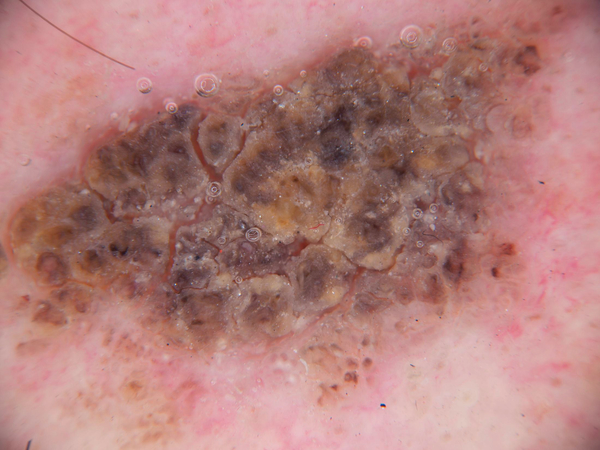

1/1 [==============================] - 0s 53ms/step
('nv', ' melanocytic nevi')


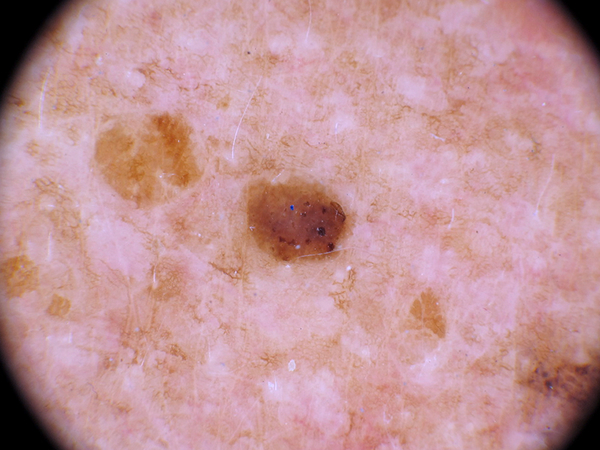

1/1 [==============================] - 0s 38ms/step
('nv', ' melanocytic nevi')


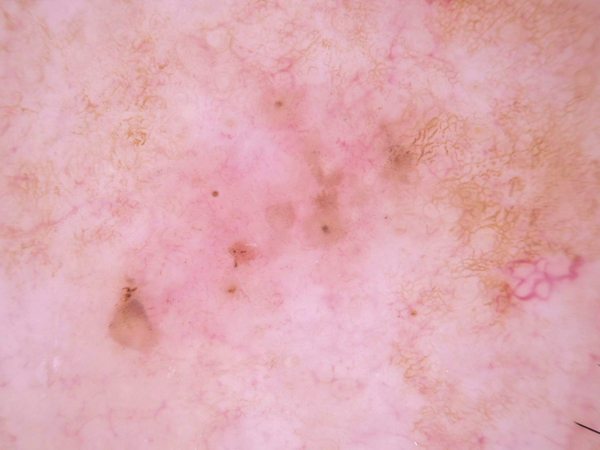

1/1 [==============================] - 0s 34ms/step
('nv', ' melanocytic nevi')


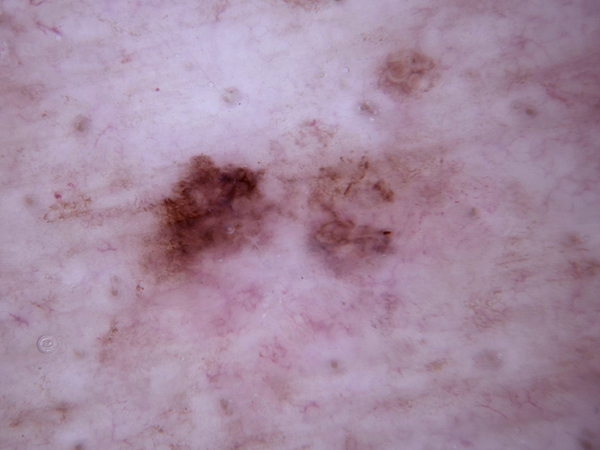

1/1 [==============================] - 0s 39ms/step
('nv', ' melanocytic nevi')


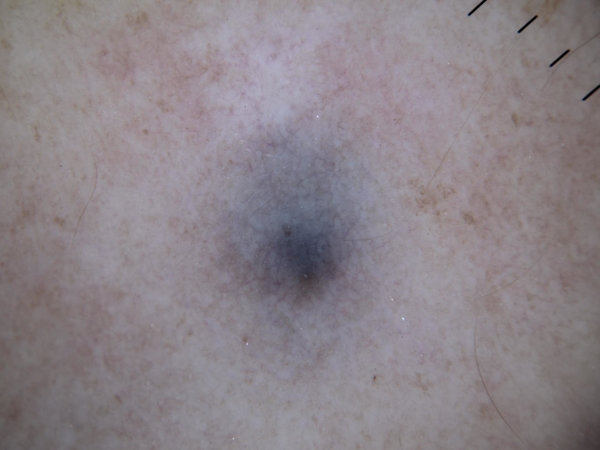

1/1 [==============================] - 0s 49ms/step
('nv', ' melanocytic nevi')


In [30]:
srcdir = '/content/drive/MyDrive/DeepLearningProject/HAM10000_images_part_1'
count=0
for temp in os.listdir(srcdir):
    img = cv2.imread(os.path.join(srcdir, temp))
    cv2.imwrite(temp, img)
    cv2_imshow(img)
    img = cv2.resize(img, (28, 28))
    result = model.predict(img.reshape(1, 28, 28, 3))
    max_prob = max(result[0])
    class_ind = list(result[0]).index(max_prob)
    class_name = classes[class_ind]
    print(class_name)
    count+=1
    if count>50:
        break

In [28]:
from google.colab import files

In [31]:
files.download("best_model.h5")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>